In [1]:
#@title Libraries

import numpy as np
import pandas as pd

from matplotlib import pyplot as plt, rcParams
import seaborn as sns

import xgboost as xg
from xgboost import cv

# from xgboost import XGBRegressor
from sklearn import model_selection, preprocessing
from sklearn.metrics import mean_squared_log_error, make_scorer, mean_squared_error, confusion_matrix, classification_report
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.model_selection import cross_validate, GridSearchCV,  KFold, cross_val_score
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, scale

from scipy.stats import skew, norm

from IPython.display import set_matplotlib_formats, display_html
from itertools import chain,cycle

#options:

set_matplotlib_formats('pdf', 'svg')
plt.rcParams.update({'figure.max_open_warning': 7000})
pd.set_option('display.max_columns', 500)
sns.set(rc={'figure.figsize':(10, 6)})
sns.set_style("whitegrid")


#**Loading the Data**

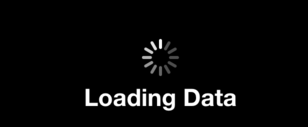

In [2]:
#@title Original Data
# df_macro =pd.read_csv('macro.csv')
df_test =pd.read_csv('test.csv', parse_dates=['timestamp'])
df_train =pd.read_csv('train.csv', parse_dates=['timestamp'])



In [3]:
#@title copy of data
# macro=df_macro.copy()
test = df_test.copy()
train = df_train.copy()
id_test = test.id


#Functions Area

---



*   EDA functions
*   Basic model and Evaluation functions


##EDA Functions


In [4]:
def display_side_by_side(*args,titles=cycle([''])):
    html_str=''
    for df,title in zip(args, chain(titles,cycle(['</br>'])) ):
        html_str+='<th style="text-align:center"><td style="vertical-align:top">'
        html_str+=f'<h2 style="text-align: center;">{title}</h2>'
        html_str+=df.to_html().replace('table','table style="display:inline"')
        html_str+='</td></th>'
    display_html(html_str,raw=True)

def percOfNull(df):
  counts = df.isna().sum() 
  percentages = round(df.isna().mean() * 100, 1)
  prec=percentages.sort_values()[::-1] #percentages of null values in cols
  cut_off = 20
  return prec.loc[lambda x : x >= cut_off]

def checkInf(df):
  numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
  newdf = df.select_dtypes(include=numerics)
  return newdf.columns.to_series()[np.isinf(newdf).any()]

def ListOfCols(df):
  i = 0
  for x in df.columns:
    print(x,end = '; ') 
    if i == 10:
      print(' ')
      i = 0
    i+=1    

def clean_dataset(df):
    assert isinstance(df, pd.DataFrame), "df needs to be a pd.DataFrame"
    indices_to_keep = ~df.isin([np.inf, -np.inf]).any(1)
    return df[indices_to_keep]

def ALL_value_counts(df):
  '''
  value counts for all cols
  '''
  i = 0
  for column in df:
      print(df[column].value_counts(),end = '; ') 
      if i == 10:
        print(' ')
        i = 0
      i+=1    

def Get_Catagorical(df):
    s = (df.dtypes == 'object')
    object_cols = list(s[s].index)
    return object_cols

def Check_Discrete(df):
  '''
  check to see what cols are discrete 
  '''
  numerical=df.select_dtypes('number').columns.tolist()
  discrete = []
  for var in numerical:
      if len(df[var].unique())<20:
          # print(var, ' values: ', df[var].unique()) #Enable if we want to see the range of values in each col
          discrete.append(var)
          
  print('There are {} discrete variables'.format(len(discrete)))
  return discrete

def find_skew(df):
  # Find skewed numerical features
  numerical=df.select_dtypes('number').columns.tolist()
  skew_features = df[numerical].apply(lambda x: skew(x)).sort_values(ascending=False)

  high_skew = skew_features[skew_features > 0.5]
  skew_index = high_skew.index
  print("There are {} numerical features with Skew > 0.5 :".format(high_skew.shape[0]))
  skewness = pd.DataFrame({'Skew' :high_skew})
  return high_skew

def Outliners_Discrete(df):
  # outliners in discrete variables
  # outliners could be a problem in tree based models we need to see what we will do with them
  numerical = df.select_dtypes('number').columns.tolist()
  discrete = []
  for var in numerical:
      if len(df[var].unique())<20:
          discrete.append(var)
  for var in discrete:
    print(df[var].value_counts() / float(len(df)))
    print()

def price_doc_to_last(train):
  last_col = train.pop('price_doc')
  train.insert(len(train.columns), 'price_doc', last_col)
  return train

##Basic model and Evaluation func

In [5]:
def RMSLE(y_true: np.array, y_pred: np.array) -> np.float64:
    """
    The Root Mean Squared Log Error (RMSLE) metric 
        
    :param y_true: The ground truth labels given in the dataset
    :param y_pred: Our predictions
    :return: The RMSLE score
    """
    log_diff = np.log1p(y_pred) - np.log1p(y_true)
    return np.sqrt(np.mean(log_diff ** 2))
    

def base_xgb(train):
  for f in train.columns:
      if train[f].dtype=='object':
          lbl = preprocessing.LabelEncoder()
          lbl.fit(list(train[f].values)) 
          train[f] = lbl.transform(list(train[f].values))

  xgb_r = xg.XGBRegressor(objective ='reg:squarederror',
                    n_estimators = 10, seed = 123)
  
  
  

  train_X, test_X, train_y, test_y = train_test_split(train.iloc[:, :-1], train.iloc[:, -1],
                        test_size = 0.3, random_state = 123)

  train_X = train_X.drop(["id", "timestamp"], axis=1)
  test_X = test_X.drop(["id", "timestamp"], axis=1)
  # Fitting the model

  

  xgb_r.fit(train_X, train_y)
  
  # Predict the model
  pred = xgb_r.predict(test_X)
  # RMSlE Computation
  rmslePred = RMSLE(test_y.to_numpy(),pred)
  return (rmslePred)



def FeatureImportanceXgb(train):
  for f in train.columns:
      if train[f].dtype=='object':
          lbl = preprocessing.LabelEncoder()
          lbl.fit(list(train[f].values)) 
          train[f] = lbl.transform(list(train[f].values))
          
  train_y = train.price_doc.values
  train_X = train.drop(["id", "timestamp", "price_doc"], axis=1)

  xgb_params = {
      'eta': 0.05,
      'max_depth': 8,
      'subsample': 0.7,
      'colsample_bytree': 0.7,
      'objective': 'reg:linear',
      'eval_metric': 'rmse',
      'silent': 1
  }
  dtrain = xg.DMatrix(train_X, train_y, feature_names=train_X.columns.values)
  model = xg.train(dict(xgb_params, silent=0), dtrain, num_boost_round=100)

  
  # plot the important features #
  fig, ax = plt.subplots(figsize=(12,18))
  xg.plot_importance(model, max_num_features=50, height=0.8, ax=ax)
  plt.show()

#**Visualization, EDA and Preprocessing**

In general in this part we analyzed the structure and patterns in the data to gain insights and understand the data better. in each step we explained what we did and what information we gained from doing so.


This Section consists of:

*   Visualizations and insights from it
*   Check for missing or null values
*   statistical analysis
*   checking for unlogical data inputs
*   Identify patterns and trends


Based on our findings of the EDA phase, we decided on the appropriate preprocessing steps to take. This may involve imputing missing values, scaling variables, or converting categorical variables into one hot encoding and more. 

##**Visualization**

###Target - price_doc

we will start our journey by looking at our target - 'price_doc'


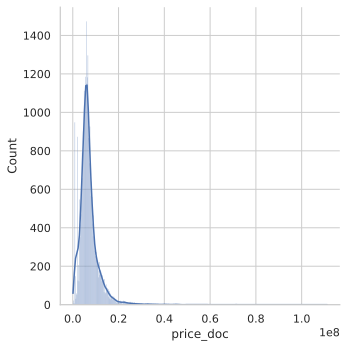

In [6]:
#@title

sns.displot(train['price_doc'], color='b',alpha=0.5,kde=True)
plt.show()

our target feature is skewed so we will think about doing a log transformation to fix it


**box plot full_sq/pricedoc**

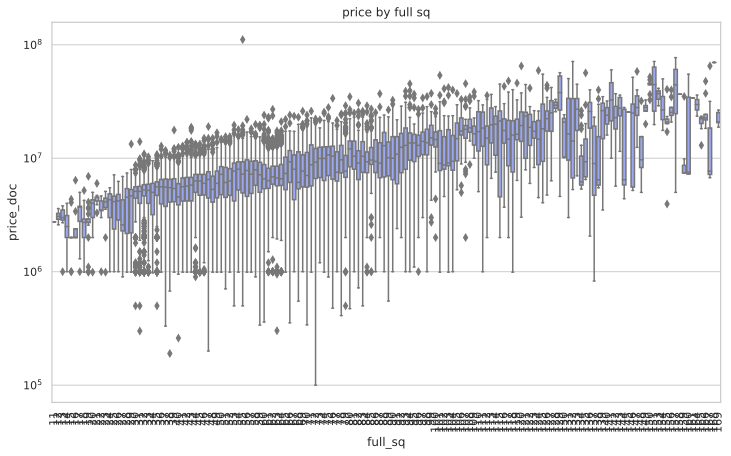

In [7]:

df_plot = train.query('10<full_sq<170')

fig, ax = plt.subplots(figsize=(12, 7))
sns.boxplot(x = 'full_sq',
            y = "price_doc",
            palette = ['#8D9EFF'], 
            data = df_plot,
            ax = ax)

ax.set(title = 'price by full sq',
       yscale = 'Log')
plt.xticks(rotation=90)
plt.show()

from this plot we can see that up until full sq is equal to about 128 there is a clear posiive connection
between the mean price increasing as the full sq increases. 128 is a saturaition point and from that point 
the connection is harder to find so we have to see if there is a different model that will fit these outliers and how many 
are there.

**pointplot full_sq vs median price**

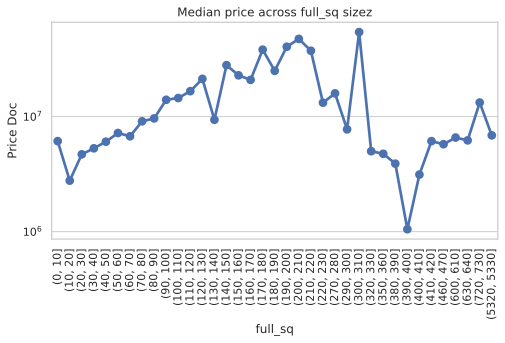

In [8]:
tuples=tuple([(i, i+10) for i in range(0,train['full_sq'].max(), 10)])

bins = pd.IntervalIndex.from_tuples(tuples)

df_bins=(
          train
         .assign(full_sq_bins = pd.cut(np.array(train['full_sq']), bins))
         .groupby('full_sq_bins',as_index=False)
         ['price_doc']
         .median()
         .dropna()
         .sort_values(by = 'full_sq_bins')
         .assign(full_sq_bins = lambda d:d.full_sq_bins.astype(str))
        )

fig,ax = plt.subplots(figsize=(8,4))

sns.pointplot(x = 'full_sq_bins', y = "price_doc", data = df_bins, join=True,ax=ax)

ax.set(
       xlabel='full_sq',
       ylabel='Price Doc',
       title="Median price across full_sq sizez",
       yscale='Log',
)
plt.xticks(rotation=90)
plt.show()

lets see how we can combat that outliners but using the median price instead of the mean, now we can see that up until the 200 mark there is a positive linear correlation  between the full sq and the price, and later on we reach a saturation point where the data behaves in a weird way, we would expect the median price to keep increasing but with a lower slope but instead the slope becomes negetive, it is possible it due to miss labeling or simply not enough data points.

**box plot of material x Price**

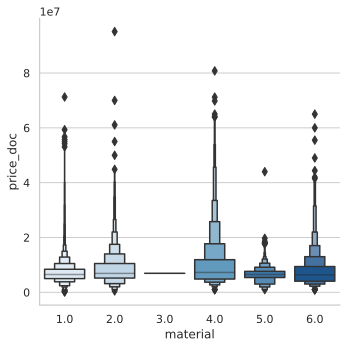

In [9]:
fig.set_size_inches(8,4)

sns.catplot(
            data = train.sort_values("material"),
            x = "material", 
            y = "price_doc",
            palette = 'Blues',
            kind = 'boxen',
            sharey = False)
plt.show()


we can see that 3 is an outlier

###Correlation exploring

In [10]:
df_all_corr = train.corr()# -1 because the latest row is price_doc
List_Of_Best_Corr = df_all_corr['price_doc'][:-1].sort_values(ascending=False)[:10]

fig, ax = plt.subplots(3, 1, figsize = (12, 16))
for i, ax in enumerate(fig.axes):
    if i <= len(List_Of_Best_Corr[:3]) :
        sns.regplot(x = List_Of_Best_Corr.index[i],
                    y = 'price_doc', 
                    data = train,
                    fit_reg = True,
                    scatter_kws = {"color": "blue"}, 
                    line_kws = {"color": "black"},
                    ax = ax
                    )
        ax.set(xlim = (train[List_Of_Best_Corr.index[i]].quantile(0.15),train[List_Of_Best_Corr.index[i]].quantile(0.9)),
               yscale = 'Log',
               title = f"regression of {List_Of_Best_Corr.index[i]} against price doc.")




we cant really see any linear connection between them which aligns with the low score of the corr, lets give correlation one last shot, this time we will take the best features from the our model and see how they corr with other features

**correlation matrix**

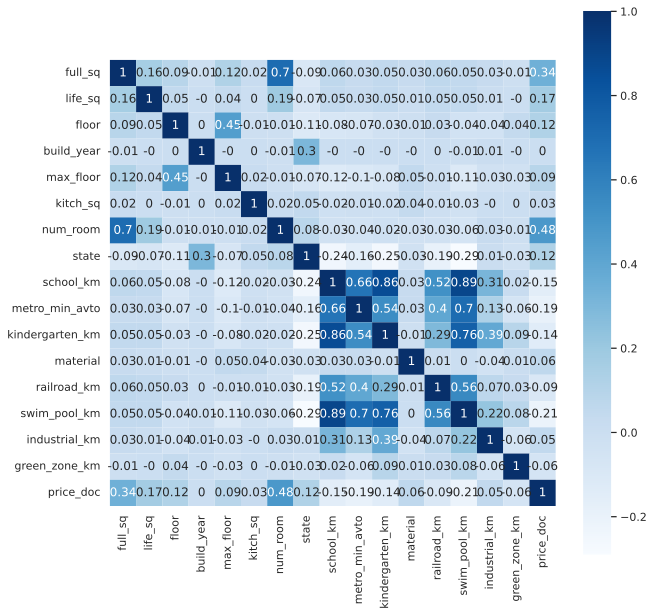

In [11]:
cor_list = ['full_sq','life_sq','floor','build_year','max_floor','kitch_sq','num_room','state','school_km','metro_min_avto','kindergarten_km',
            'material','railroad_km', 'swim_pool_km','sub_area','industrial_km','green_zone_km','price_doc']

corrmat = (
            train[cor_list]
           .corr()
           .round(2)
          )

fig, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(corrmat, vmax=1, cmap='Blues',square=True, annot=True)
plt.show()


we can see some srong connections between a few of the features, lets take a deeper dive



1.   swim_pool;school - makes sense as there are pools inside schools

2.   kindergarden;school - they are usually build nearby

3.   full_sq;num_room - straightforward, the bigger the house, the more likely it will have a high number of rooms 


when there is a high corr between features we need to be mindful about having both of them in our model

###Median Price distribution by month_of_year

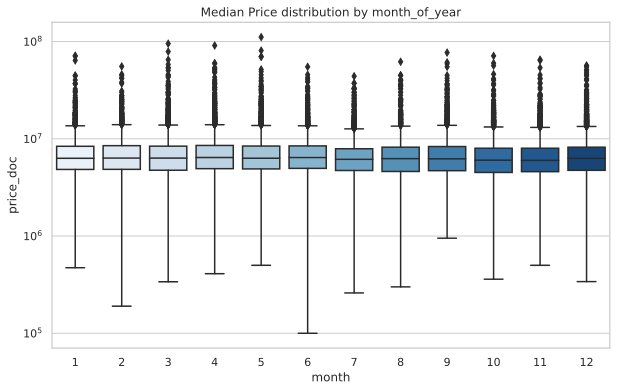

In [12]:


plot_df = (
          train
          .assign(year = train["timestamp"].dt.year,
                  month = train["timestamp"].dt.month,
                  day = train["timestamp"].dt.day)
          )

fig, ax = plt.subplots(figsize=(10,6))

sns.boxplot(x = 'month', y = 'price_doc',palette = 'Blues', data = plot_df,ax=ax)

ax.set(ylabel = 'price_doc',
       xlabel = 'month',
       title = 'Median Price distribution by month_of_year',
       yscale = 'Log')

plt.show()



We can see a uniform dist between to the median price each month, making us think that the month wont be a big factor

###Product type

In [13]:
fig,ax = plt.subplots(figsize=(10,6))

sns.scatterplot(x = 'full_sq',
                y = 'price_doc',
                data = train,
                hue = 'product_type',
                ax = ax)
ax.set(yscale = 'Log',
       xlim = (10,200))

plt.show()

thats intersting, it seems like we can fit pretty well a stright line on the ownerOccupier group but the Investment ones are all spread out, Another takeaway from this plot is that we can see that most of the lower prices are from the Investment types, giving us an idea about splitting our model into 2, one that will predict Investments and one that will predict OwnerOccupier, but thats for much later on.

###build year

**Num of Buildings Across Year**

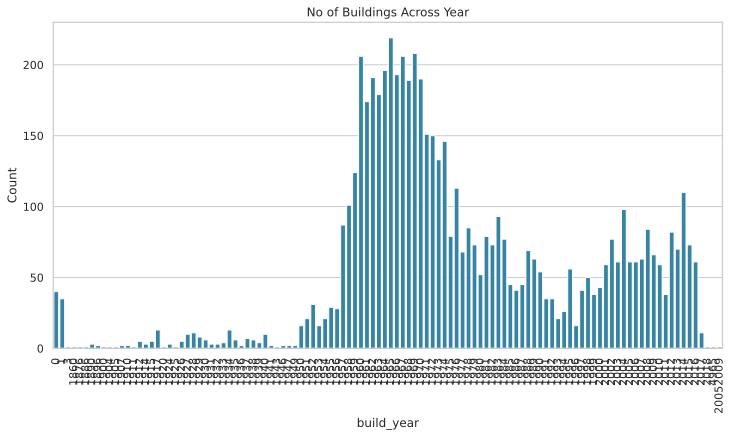

In [14]:
fig,ax= plt.subplots(figsize=(12,6))

plot_df = (
          train
          .dropna()
          .assign(build_year=lambda d:d.build_year.astype('int32'))
          )

sns.countplot(data = plot_df,
              x = "build_year",
              palette = ['#248ab5'],
              ax = ax)

ax.set(xlabel = 'build_year', 
       ylabel = 'Count',
       title = "No of Buildings Across Year",
       label = 'big')

plt.xticks(rotation=90)
plt.show()


first thing we can see is that there are around 50 properties with unreasonable build year(0,1,2) which we later change to NaN

we can see that all  known build years under 1500 are few and therefore we can think about doing  binning and label them as very old, old, recent, and future, we will compare the model performance without binning and with to see if it made a good impact


**Average Price_doc Across Year build**

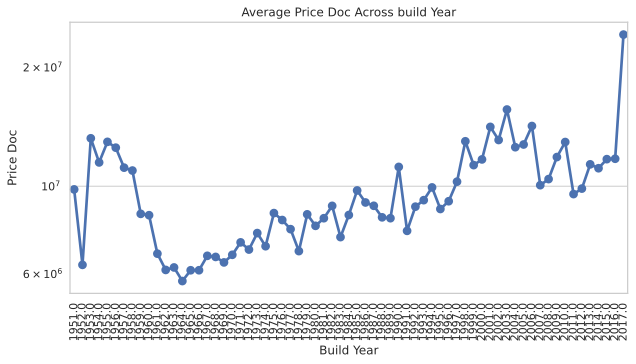

In [15]:
fig,ax= plt.subplots(figsize=(10,5))

plot_df = (
            train
            .query('1950<build_year<2018')
            .dropna()
            .sort_values('build_year')
            .groupby('build_year',as_index=False)
            ['price_doc']
            .mean()
          )

sns.pointplot(x = 'build_year', 
              y = 'price_doc', 
              data = plot_df,
              join = True,
              ax = ax
              )

ax.set(xlabel = 'Build Year', 
       ylabel = 'Price Doc',
       title = "Average Price Doc Across build Year",
       label = 'big',
       yscale = 'Log')

plt.xticks(rotation=90)

plt.show()


because we saw in the previous plot that there are few observations between years 0 to 1500 we wont give a big significance 
to the disturbition in those years, instead we will focus on the relavent years. By analysing the graph we can see that from around 1960 there is a clear growth of the avg
price per build year which makes sense to what we thought, which is the newer the house the more it costs.
the houses in the first section(1500-1960) behave differently, we can assume it due to lack of data of those years and the variance of each propertiy is big

###Floor Vs Price Doc

**Floor Vs Price Doc Box plot**

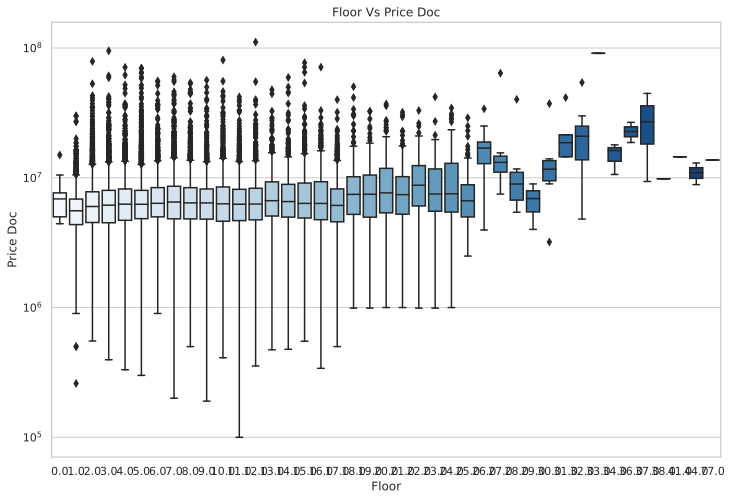

In [16]:
fig,ax= plt.subplots(figsize=(12,8))

sns.boxplot(x = "floor", 
            y = "price_doc", 
            data = train,
            palette = 'Blues',
            ax = ax
            )

ax.set(ylabel = 'Price Doc',
       xlabel = "Floor",
       title = "Floor Vs Price Doc",
       yscale = 'Log')
plt.show()

From the first look it looks like there is no clear difference between the floor and the avg/median price but the scaling of the graph makes it hard to distinguish, we have a better look at the next graph, what we can see is that that after the 25 we reach a saturation point(which makes more sense to us), we will think about either removing the outliners or we will bin the number of floors to under 25 and above 25.

**Floor under 25 vs Avg Price**

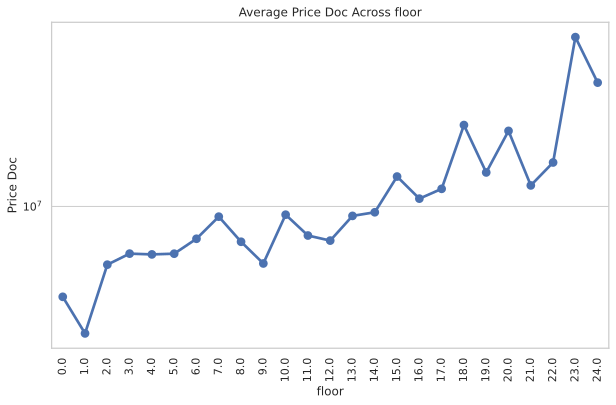

In [17]:
plot_df = (
            train
            .rename(columns = {'floor':'floor2'}) #as floor is a math function which causes problem in query
            .pipe(lambda d:d.query('floor2<25')) 
            .dropna()
            .groupby('floor2',as_index=False)
            ['price_doc']
            .mean()
          )

fig,ax= plt.subplots(figsize=(10,6))

sns.pointplot(x = "floor2", 
              y = "price_doc", 
              data = plot_df,
              ax = ax)

ax.set(xlabel = 'floor', 
       ylabel = 'Price Doc',
       title = "Average Price Doc Across floor",
       label = 'big',
       yscale= 'Log')

plt.xticks(rotation=90)

plt.show()



Thats better, now we can see that we can fit a line and see there a positive connection between the floor number and the avg price

###Sub Area

We Will start by creating a sub_area df that will have some features that we can explore

**Creating the Sub Area dataframe**

In [18]:
Sub_Area_DF = (
               train
              .assign(price_per_sq = train['price_doc'].divide(train['full_sq']))
              .replace([float('inf'), float('-inf')], [np.NaN, np.NaN])
              .groupby('sub_area',as_index=False)
              .agg({'price_per_sq':['mean','median'],'price_doc':['mean','median'],'build_year':['mean','median'],'id':['count']})
              .set_axis(['sub_area','mean_price_per_square','median_price_per_square','mean_price_per_sub_area','median_price_per_sub_area',
                          'avg_build_year','median_build_year','count'], axis='columns')
              )
Sub_Area_DF.describe()

,mean_price_per_square,median_price_per_square,mean_price_per_sub_area,median_price_per_sub_area,avg_build_year,median_build_year,count
count,146.000000,146.000000,1.460000e+02,1.460000e+02,146.000000,146.000000,146.000000
mean,145936.888156,149563.803784,7.640464e+06,6.999736e+06,3237.188838,1966.308219,208.705479
std,46777.631631,42979.797138,2.894105e+06,2.305252e+06,15961.269808,164.684602,247.425117
min,23255.813953,19298.245614,1.000000e+06,1.000000e+06,732.636364,0.000000,1.000000
25%,122685.065002,130592.105263,5.853499e+06,5.800000e+06,1944.778017,1967.250000,98.250000
50%,143778.878312,155066.413662,7.102451e+06,6.675000e+06,1968.751883,1974.500000,154.500000
75%,167303.277679,174286.130536,8.959793e+06,7.881250e+06,1978.432822,1989.000000,223.000000
max,298157.494175,275675.675676,2.011657e+07,1.562500e+07,194766.048077,2014.000000,1776.000000


Now lets plot that data and see what can we find

**prices analysis per sub area**

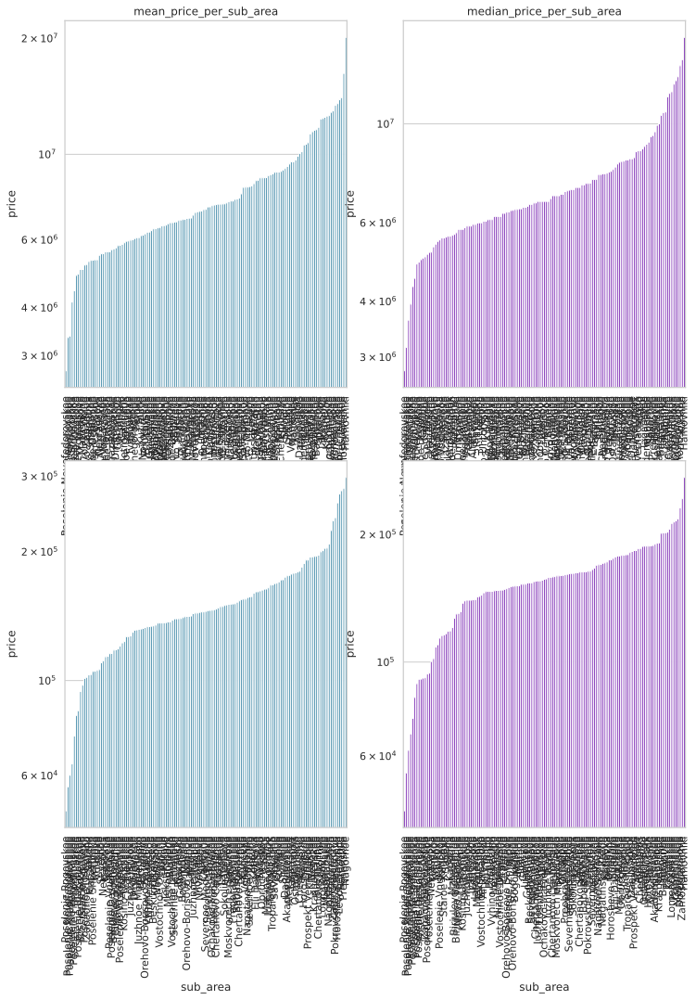

In [19]:
List = ['mean_price_per_sub_area','median_price_per_sub_area','mean_price_per_square','median_price_per_square']
Colors = ['#248ab5','#7802c7','#248ab5','#7802c7']

fig, ax = plt.subplots(2, 2, figsize = (12, 16))
for i, ax in enumerate(fig.axes):
      plot_df=(
               Sub_Area_DF
              .query('count>20')
              .sort_values(List[i])
              )
      sns.barplot(x = "sub_area", 
                  y = List[i],
                  data = plot_df,
                  palette = [Colors[i]],
                  ax = ax)
      ax.set(ylabel = 'price',
            xlabel = "sub_area",
            title = List[i],
            yscale = 'Log')
      ax.set_xticklabels(plot_df['sub_area'], rotation=90)


We can see there is a clear difference between different sub_area, which fits with our everyday knowledge that differents parts of the same city are priced differently

**build year analysis per sub area**

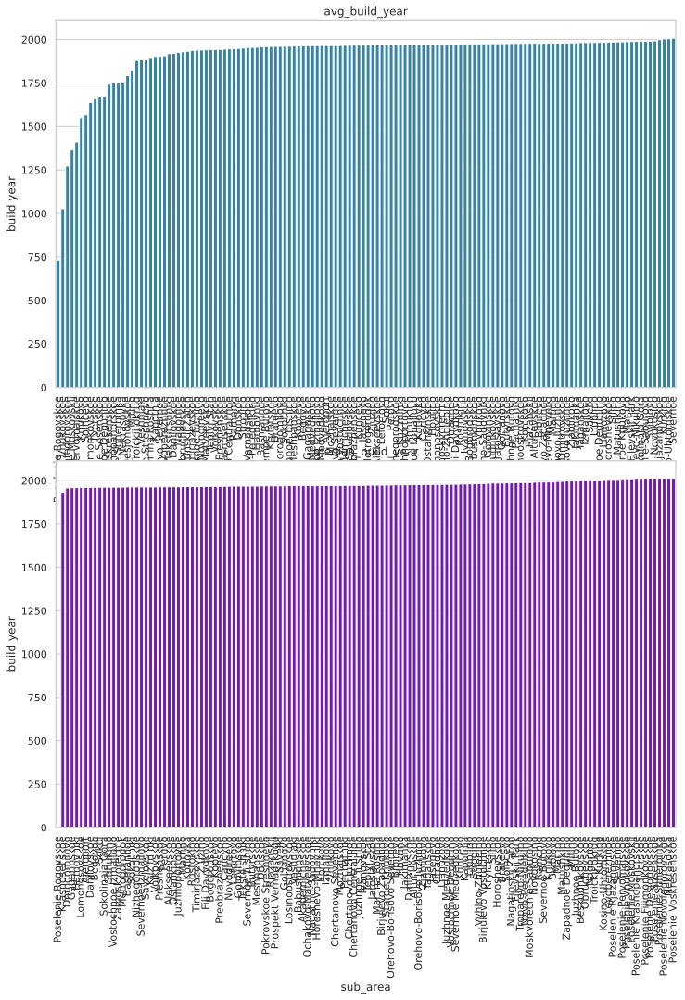

In [20]:
List2 = ['avg_build_year','median_build_year']
Colors2 = ['#248ab5','#7802c7']

fig, ax = plt.subplots(2, 1, figsize = (12, 16))
for i, ax in enumerate(fig.axes):
      plot_df = (
                  Sub_Area_DF
                  .query('count>20 and avg_build_year <2023')
                  .sort_values(List2[i])
                  )
      sns.barplot(x = "sub_area", 
                  y = List2[i],
                  data = plot_df,
                  palette = [Colors2[i]],
                  ax = ax)
      ax.set(ylabel = 'build year',
            xlabel = "sub_area",
            title = List2[i])
      ax.set_xticklabels(plot_df['sub_area'], rotation=90)

we can see that  almost each sub area has around the same avg building age, meaning there arent any 'new'/'old' sub areas, so transforming sub areas into a new/old catagory wont help us, theres one sub area - 'Cheremushki' which is suspiciously high, we will use the median to combat this outliner


we later found out that one there is bad data input in one of the lines which lists one of the build years way ahead in the distance future which makes the avg of the sub area so high

###discrete features

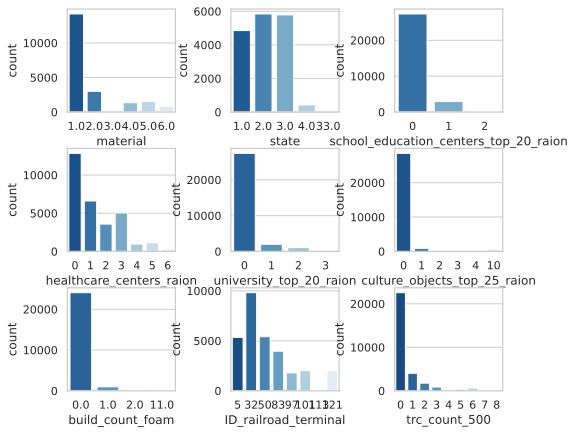

In [21]:


numerical = train.select_dtypes('number').columns.tolist()
discrete = []
for var in numerical:
    if len(train[var].unique())<10:
        discrete.append(var)


fig, ax = plt.subplots(3, 3, figsize = (7, 6))
fig.tight_layout()
for i, ax in enumerate(fig.axes):
    if i < len(discrete) - 1:
        sns.countplot(x = discrete[i],
                      data = train,
                      palette = 'Blues_r',
                      ax = ax)
      
      

We can see that some categories are predominant for some features such as 'build_count_foam','culture_objects_top_25' and 'university_top_20_raion' These features may not be relevant for our prediction model

#**Exploratory Data Analysis**




---


*   Null exploration and handling
*   faulty logic data
*   dist and types of features



##Checking for NULLS

We checked precentages of null in our data, then we checked the type of our data. we used one hot encoding to transform catigorical data so our models have a better understanding of the values.

We combed through our data to find and fix unlogical data. We switched the inlogical data to null as a first fix, that way when we deal with null it will be part of the process.

For null values we came up with 4 possible solutions:
 remove all nulls, fill null values with median,mean 

1.   remove all nulls 
2.   fill null values with median,mean or mode  of the relavent column
3.  using a random forest model to predict the missing values
4.  using a model that can hadle Null values such as Xgboost

finally, after trying the base model with each of the three options, the best option that worked for us was to fill nulls with mean of each columns.



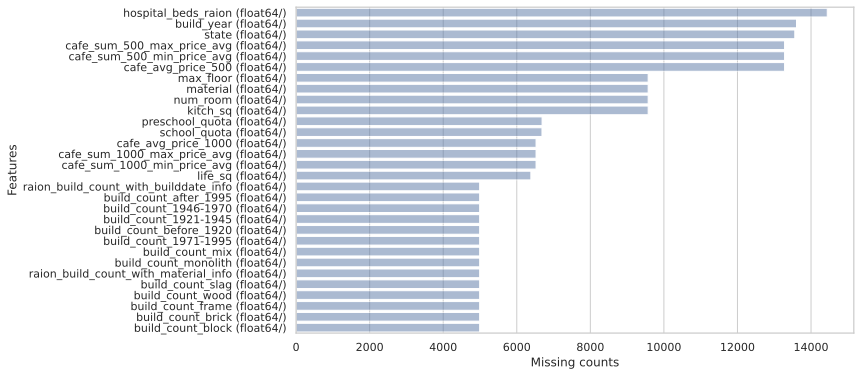

In [22]:
#@title missing data visualization

plot_df = (
          train
          .isnull()
          .sum(axis=0)
          .reset_index()
          .set_axis(["column header", "missing_count"],axis=1)
          .query('missing_count > 0')
          .sort_values('missing_count',ascending=False)
          .head(30)
          )

ax = sns.barplot(x = 'missing_count',
                 y = 'column header',
                 data = plot_df,
                 alpha=0.5, 
                 color='b')

ax.set(
      ylabel = 'Features',
      xlabel = 'Missing counts',   
)

labels = plot_df['column header'].values.tolist()
newlabels = []
for feature in labels:
    newlabels.append(f"{feature} ({train[feature].dtypes}/)")

ax.set_yticklabels(newlabels)
plt.show()



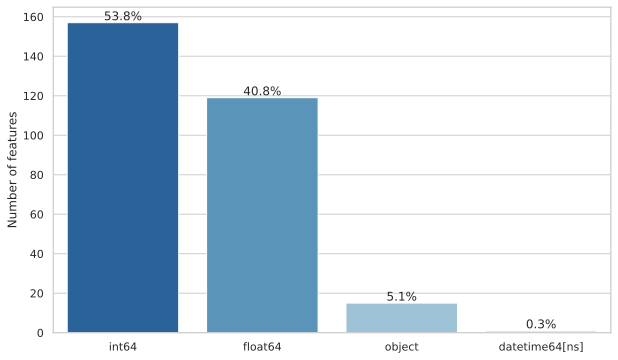

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30471 entries, 0 to 30470
Columns: 292 entries, id to price_doc
dtypes: datetime64[ns](1), float64(119), int64(157), object(15)
memory usage: 67.9+ MB


In [23]:
#@title looking at dtypes

dtypes_counts = train.dtypes.value_counts()
total_features = len(train.columns)
dtypes_percentages = dtypes_counts / total_features * 100

fig, ax = plt.subplots()

sns.barplot(x = dtypes_counts.index.astype(str),
            y = dtypes_counts,
            palette = 'Blues_r',
            ax = ax)

ax.set_ylabel('Number of features')


for i, p in enumerate(ax.patches):
    percentage = f'{dtypes_percentages.iloc[i]:.1f}%'
    x = p.get_x() + p.get_width() / 2
    y = p.get_height()
    ax.text(x, y, percentage, ha='center', va='bottom')

plt.show()

train.info() 

###Labeling wrong/unlogical data as NaN

In [24]:
def Wrong_to_null(df):
  df.loc[df['build_year'] < 1000, 'build_year'] = np.NaN
  df.loc[df['build_year'] > 2050, 'build_year'] = np.NaN
  df.loc[df['full_sq'] < 5, 'full_sq'] = np.NaN
  df.loc[df['kitch_sq'] == 0, 'kitch_sq'] = np.NaN
  df.loc[df['kitch_sq'] > 1500 , 'kitch_sq'] =np.NaN
  df.loc[df['floor'] > df['max_floor'], "max_floor"] = np.NaN 
  df.loc[df['num_room'] == 0,'num_room'] = np.nan

  df.loc[df['life_sq'] - df['full_sq'] <= 10 ,'full_sq'] = df['life_sq']
  df.loc[df['life_sq'] - df['full_sq'] >= 100 ,'life_sq'] = df['life_sq'] / 10
  df.loc[df['life_sq'] - df['full_sq'] >= 100 ,'life_sq'] = df['life_sq'] / 10 #we did it twice because there was a number in the thousends
  return df


In [25]:
def fix_train(train):
    train.loc[train['build_year'] == 20052009,'build_year'] = 2005
    train.loc[train['build_year'] == 20,'build_year'] = 2000
    train.loc[train['build_year'] == 215,'build_year'] = 2015
    train.loc[train['build_year'] == 71,'build_year'] = 1971
    train.loc[[23584], "floor"] = np.NaN
    train.loc[13117,'build_year'] = train.at[13117,'kitch_sq']
    train.loc[train['state'] == 33, 'state'] = 3
    return train

after taking a look at our data types to better understand our features.
we saw:
timestamp is a date type so to be able to use this info to seperate day/month/week 
product_type -its an object so we will change to a dummy variable
sub_area - use groupby to understand this feature more.
change yes/no cols into a binary 
in ecology we found no data instead null so we need to go over ecology search for no data and redfind as Null, and later change to dummies and see what to do with nulls

In [26]:
def eda_fixes(df):
  '''
  includes:
  turnning yes/no to boolean, 
  removing id features, 
  turning catagorial features into dummies
  '''

  return (df
          .replace({'yes':1,'no':0,'no data':np.NaN})
          .drop([col for col in df if col.startswith('ID')], axis = 1)
          .pipe(lambda d: pd.get_dummies(d,columns=['ecology']))
          .pipe(lambda d:Wrong_to_null(d))
          )
  
train = (
          eda_fixes(train)
          .pipe(lambda d:fix_train(d))
        )

test = eda_fixes(test)

print(f'''
      "Skewness of price_doc: {train['price_doc'].skew():.3f}
      "Kurtosis of price_doc: {train['price_doc'].kurt():.3f}
      ''')


      "Skewness of price_doc: 4.475
      "Kurtosis of price_doc: 44.027
      


#Test Exploration

in this section we will try to see the boundries of that data we are tested on, we want to train our model on the closest thing we can.

we will start by going over the sub areas of each dataset and tried to see if there are areas which arent present in both, if those sub areas contains a lot of datapoint with nulls we might remove those datapoints from the train df,

next we will look at the null values in the test dataset and how it compares to our train, and finally we will take a look at  our most important features according to the XGB Model and we will perform T test to see if there is a significant difference between the two groups




we will look at our most important features from the xgb model and see the range of those values in both dfs

In [27]:
list1 = list(df_test['sub_area'].value_counts().index)
list2 = list(df_train['sub_area'].value_counts().index)
s = set(list1)
diff = [x for x in list2 if x not in s]
print('list of sub areas that arent in both datasets:','\n',diff)

list of sub areas that arent in both datasets: 
 ['Poselenie Klenovskoe']


In [28]:
#@title Null difference
dict1 = percOfNull(df_test).to_dict()
dict2 = percOfNull(df_train).to_dict()
common_keys = [key for key in dict1.keys() if key in dict2.keys()]
unique_keys = [key for key in dict2.keys() if key not in dict1.keys()]
print(f"list of features that have above the cutoff perc of Null that are present in both datasets: {common_keys} \nlist of features that have above the cutoff perc of Null that arent present in both dataset: {unique_keys}")


list of features that have above the cutoff perc of Null that are present in both datasets: ['hospital_beds_raion', 'cafe_sum_500_min_price_avg', 'cafe_avg_price_500', 'cafe_sum_500_max_price_avg', 'preschool_quota', 'school_quota'] 
list of features that have above the cutoff perc of Null that arent present in both dataset: ['build_year', 'state', 'max_floor', 'material', 'num_room', 'kitch_sq', 'cafe_sum_1000_min_price_avg', 'cafe_sum_1000_max_price_avg', 'cafe_avg_price_1000', 'life_sq']


In [29]:
#@title T-Tests between the two datasets
test1 = df_test.copy()
train1 = df_train.copy()
ListImportance = ['timestamp','full_sq', 'life_sq', 'floor', 'max_floor', 'build_year', 'kitch_sq',
                  'kindergarten_km', 'state', 'num_room', 'metro_min_avto',
                  'green_zone_km']

test1['is_test'] = 1
train1['is_test'] = 0

all = pd.concat([train1.dropna(), test1.dropna()],ignore_index=True)
all = all[ListImportance+['is_test']]
from scipy.stats import ttest_ind
#h0  - there is no difference between groups
test_cat = all[all['is_test']==1]
train_cat = all[all['is_test']==0]
Stats = {}
for feature in ListImportance[1:]:
  Stats[feature] = ttest_ind(test_cat[feature], train_cat[feature])[1]
p_value_df = pd.DataFrame(Stats,index=[0])
print('The Features with significant difference between the two datasets:')
print(list(p_value_df.T.loc[p_value_df.T[0]<0.05].index))


The Features with significant difference between the two datasets:
['life_sq', 'floor', 'kitch_sq', 'state', 'metro_min_avto', 'green_zone_km']


with those features we should be more careful about overfitting, might add a regularization penalty only one those specific features

In [30]:
#@title
display(train1[ListImportance].describe())
display(test1[ListImportance].describe())

,full_sq,life_sq,floor,max_floor,build_year,kitch_sq,kindergarten_km,state,num_room,metro_min_avto,green_zone_km
count,30471.000000,24088.000000,30304.000000,20899.000000,1.686600e+04,20899.000000,30471.000000,16912.000000,20899.000000,30471.000000,30471.000000
mean,54.214269,34.403271,7.670803,12.558974,3.068057e+03,6.399301,0.981684,2.107025,1.909804,4.961273,0.300511
std,38.031487,52.285733,5.319989,6.756550,1.543878e+05,28.265979,2.121956,0.880148,0.851805,6.553515,0.298402
min,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000470,1.000000,0.000000,0.000000,0.000000
25%,38.000000,20.000000,3.000000,9.000000,1.967000e+03,1.000000,0.199946,1.000000,1.000000,1.721280,0.100951
50%,49.000000,30.000000,6.500000,12.000000,1.979000e+03,6.000000,0.353762,2.000000,2.000000,2.803299,0.214336
75%,63.000000,43.000000,11.000000,17.000000,2.005000e+03,9.000000,0.971417,3.000000,2.000000,4.831733,0.415498
max,5326.000000,7478.000000,77.000000,117.000000,2.005201e+07,2014.000000,29.085774,33.000000,19.000000,61.438472,1.982448


,full_sq,life_sq,floor,max_floor,build_year,kitch_sq,kindergarten_km,state,num_room,metro_min_avto,green_zone_km
count,7662.000000,6486.000000,7662.000000,7662.000000,6613.000000,7662.000000,7662.000000,6968.000000,7662.000000,7662.000000,7662.000000
mean,53.701164,32.660037,7.652571,12.591099,1820.888099,6.938662,1.103444,1.985792,1.876403,4.669771,0.304987
std,20.104320,22.737855,5.099418,6.659291,552.993964,25.579688,2.781981,0.820086,0.835665,6.142312,0.275347
min,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000470,1.000000,1.000000,0.009021,0.000000
25%,39.200000,19.900000,4.000000,9.000000,1966.000000,1.000000,0.204924,1.000000,1.000000,1.717658,0.112066
50%,50.410000,30.400000,7.000000,14.000000,1982.000000,7.000000,0.389760,2.000000,2.000000,2.641019,0.230923
75%,63.300000,41.800000,11.000000,17.000000,2011.000000,9.500000,0.944998,3.000000,2.000000,4.614906,0.427248
max,403.000000,869.000000,41.000000,48.000000,2019.000000,1968.000000,27.453271,4.000000,19.000000,65.101125,2.036755


We tried removing all data points from the train datset that exceeds the limits of test dataset, sadly we didnt see any improvement doing so.

In [31]:
test['timestamp'].sort_values()

0      2015-07-01
14     2015-07-01
13     2015-07-01
11     2015-07-01
10     2015-07-01
          ...    
7657   2016-05-26
7658   2016-05-28
7660   2016-05-30
7659   2016-05-30
7661   2016-05-30
Name: timestamp, Length: 7662, dtype: datetime64[ns]

thats intersting, we can see that the the test set only contains info from 2nd half of 2015 to first half of 2016, maybe we will be able to use it in the future 

#**Baseline model**

Using Cross validation our model has definitly improved compared to the base model, even then this is still a concern for overfitting, we can using regularization methods such as lasso and ridge to make sure our model doesnt become too complicated and isnt able to generalize very well. 

we expected the model to not perfom the best as we filled a large number of null values with the mean of the column, taking away valuable information, in addition  random forest samples a number of random features for each decision tree that is build, meaning if we have a large amount of features that are arent impactful we can lose a lot of info for not sampling the right ones, therfore when the hyper parameters of the model arent tuned the model lacks significantly compared to its full potential 


possible ways to improve the model:

*   Using a more advanced model such as xgboost
*   Tuning the model hyperparameters
*   Adding new features
*   Better handling of Missing values
*   Removing Outliners
*   Ensabmle of multipul models




In [32]:
def plot_feature_importance(importance,names,model_type,cutoff):

  #Create arrays from feature importance and feature names
  feature_importance = np.array(importance)
  feature_names = np.array(names)
  
  #Create a DataFrame using a Dictionary
  data={'feature_names':feature_names,'feature_importance':feature_importance}
  fi_df = pd.DataFrame(data)

  #Sort the DataFrame in order decreasing feature importance
  fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)
  fi_df = fi_df.iloc[:10,:]
  #Define size of bar plot
  plt.figure(figsize=(6, 8))  
  #Plot Searborn bar chart
  sns.barplot(x = fi_df['feature_importance'], y = fi_df['feature_names'],palette='Blues_r')
  #Add chart labels
  plt.title(model_type + ' FEATURE IMPORTANCE')
  plt.xlabel('FEATURE IMPORTANCE')
  plt.ylabel('FEATURE NAMES')


In [33]:

def base_RF(train):
  for f in train.columns:
      if train[f].dtype=='object':
          lbl = preprocessing.LabelEncoder()
          lbl.fit(list(train[f].values)) 
          train[f] = lbl.transform(list(train[f].values))
  rf =  RandomForestRegressor(max_depth=6, random_state=0)


  train_X, test_X, train_y, test_y = train_test_split(train.iloc[:, :-1], train.iloc[:, -1],
                        test_size = 0.3, random_state = 123)

  train_X = train_X.drop(["id", "timestamp"], axis=1)
  test_X = test_X.drop(["id", "timestamp"], axis=1)
  # Fitting the model
  model=rf.fit(train_X, train_y)
  # Predict the model
  pred = rf.predict(test_X)
  # RMSlE Computation
  rmslePred = RMSLE(test_y.to_numpy(),pred)

  max_value=np.amax(np.maximum(test_y,pred)).item()
  min=np.amin(np.minimum(test_y,pred)).item()

  plot_feature_importance(model.feature_importances_,train.drop(["id", "timestamp",'price_doc'], axis=1).columns,'RANDOM FOREST',20)
  

  # Set the figure size
  plt.figure(figsize=(6, 8))

  # Plot the predicted values against the actual values
  plt.scatter(pred, test_y,alpha=0.5)

  # Add a line to show the perfect prediction line
  plt.plot([0, max_value], [0, max_value], linestyle='--', color='red')
  
  # Add axis labels and a title
  plt.xlabel('Predicted Values')
  plt.ylabel('Actual Values')
  plt.title('Predicted vs Actual Values')
  
# Show the plot
  plt.show()


  plt.figure(figsize=(6, 8))
  residuals = pred - test_y

  # Plot the residuals
  plt.scatter(pred,residuals,alpha=0.5)

  # Add a title and axis labels
  # plt.title('Residuals')
  plt.xlabel('Predicted values')
  plt.ylabel('Residuals')

  # Show the plot
  plt.show()



  return rmslePred
  

#**Feature Enginerring**

**There are several factors that can affect the price of houses in Moscow:
factors we uses to create features:**

Size: Larger houses generally have a higher price tag. therefore we made a feature lifeToFull to have a better estimation of the size and type of apartment.

Age: Older houses may be less expensive, but they may also require more maintenance and renovations.Therefore we made a feature that calculates the age of the building.

Demand: If there is a high demand for houses in a particular area, prices may be driven up.therefore we made a feature that looks at percentages of invesment vs owner occupation that better understand the type of demand.

Amenities: Houses with amenities such as a pool or a garage may be more expensive. We used this as an idea to further understand what would improve the price based on amenities therefore we built a feature that give a score to an area to further explain our perdiction.

**factors we will further explore in the final project:**
Location: Houses in the city center or in desirable neighborhoods tend to be more expensive. 

Condition: A well-maintained house will typically be more expensive than a house in need of repairs.

Economic conditions: Changes in the economy can affect the housing market, with prices rising or falling depending on factors such as interest rates and employment.

In [34]:
#@title split timestamp
def split_timestamp(df):
  return (
          df
         .assign(year = df["timestamp"].dt.year,
                 month =df["timestamp"].dt.month,
                 day = df["timestamp"].dt.day)
          )
  
train = split_timestamp(train)
test = split_timestamp(test)

We understood that time has a big affect on the price of an apartment therefore we split the timestamp with was of type date to be different features so our models will be able to use them.

In [35]:
#@title LifeTofull/KitchToLife ratio

def LifeToKitch(df):
  return (
          df
          .assign(lifeToFull=df['life_sq']/df['full_sq'])
          .replace([float('inf'), float('-inf')], [np.NaN, np.NaN])
         )

train = LifeToKitch(train)
test = LifeToKitch(test)

We checked that the logic between life sq and full sq makes sense. If there was ilogical data we changed it to null. 
As for the kitch, at first we thought that we can fix the same issues for the kitch_sq by checking against life_sq however with further exploration of our data we have come to understand that that was a mistake because that life_sq doesnt contain kitch_sq.

In [36]:
#@title # yearweek combo and yearmonth combo #

def dates_combo(df):
  return (
          df
         .assign(yearmonth=df["timestamp"].dt.year*100 + df["timestamp"].dt.month,
                 yearweek=df["timestamp"].dt.year*100 + df["timestamp"].dt.weekofyear)
         )
  
train = dates_combo(train)
test = dates_combo(test)

<ipython-input-36-db2f83e15c86>:7: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  yearweek=df["timestamp"].dt.year*100 + df["timestamp"].dt.weekofyear)


In [37]:
#@title Floor Features

def FloorFeatures(df):
  return (
          df
         .assign(ratio_floor_max_floor=df["floor"] / df["max_floor"].astype("float"),
               floor_from_top=df["max_floor"] - df["floor"],
               penthouse= df['floor']==df['max_floor'])
         .replace([float('inf'), float('-inf')], [np.NaN, np.NaN])
         )
train = FloorFeatures(train)
test = FloorFeatures(test)

In [38]:
#@title Adding balconies as a feature
train["extra_sq"] = train["full_sq"] - train["life_sq"]
test["extra_sq"] = test["full_sq"] - test["life_sq"]

In [39]:
#@title Age of the building
train["age_of_building"] = 2018 - train["build_year"]
test["age_of_building"] =  2018 - test['build_year']

In [40]:
#@title #A counter for how many houses are on the market

def add_count(df, group_col): 
    '''
    counter for how many houses are the on the market 
    '''
    grouped_df = df.groupby(group_col)["id"].aggregate("count").reset_index()
    grouped_df.columns = [group_col, "count_"+group_col]
    df = pd.merge(df, grouped_df, on=group_col, how="left")
    return df

train = add_count(train, "yearmonth")
test = add_count(test, "yearmonth")
train = add_count(train, "yearweek")
test = add_count(test, "yearweek")

In [41]:
#@title change in monthy demand in the market

def changeInDemand(df):
  CYM=(
      df
      .groupby('yearmonth',as_index=False)
      ['count_yearmonth']
      .mean()
      )
  return (
          df
          .groupby('yearmonth',as_index=False)
          ['count_yearmonth']
          .mean()
          .diff()
          .divide(CYM)
          .assign(yearmonth=CYM.yearmonth)
          .rename(columns={'count_yearmonth':'monthly_change_in_demand'})
          .merge(df,how='right',on='yearmonth')
          .pipe(lambda d:d.loc[:, d.columns[2:].tolist() + ['yearmonth','monthly_change_in_demand']])
          )
train = changeInDemand(train)
test = changeInDemand(test)


In [42]:
#@title linear combination of existing columns

#preschool ratio
#school ratio
#Area per room

def LinearCombo(df):
  return (
          df
          .assign(ratio_preschool=df["children_preschool"] / df["preschool_quota"].astype("float"),
                  ratio_school=df["children_school"] / df["school_quota"].astype("float"),
                  Area_per_room=df['life_sq']/df['num_room'])
          .replace([float('inf'), float('-inf')], [np.NaN, np.NaN])
         )
train = LinearCombo(train)
test = LinearCombo(test)

In [43]:
#@title binning build years 
def BinningBuildYears(df):
  ranges = [(1000, 1960), (1961, 1950), (1950, 2000), (2000, 2018), (2018, 2025)]
  return (
          df
         .assign(very_old = ((df['build_year'] <= ranges[0][1]) & (df['build_year'] <= ranges[0][0])).astype(int),
               old = ((df['build_year'] > ranges[0][1]) & (df['build_year'] <= ranges[1][1])).astype(int),
               semi_old = ((df['build_year'] > ranges[1][1]) & (df['build_year'] <= ranges[2][1])).astype(int),
               new = ((df['build_year']> ranges[2][1]) & (df['build_year'] <= ranges[3][1])).astype(int),
               in_progress = (df['build_year'] > ranges[3][1]).astype(int))
         .drop('build_year',axis=1)
       )
train = BinningBuildYears(train)
test = BinningBuildYears(test)

In [44]:
#@title Quiet Area
def quiet(df):
  Noisy_list = ['railroad_station_walk_km','railroad_station_avto_km','big_road1_km',
              'big_road2_km','nuclear_reactor_km','workplaces_km','incineration_km']
  return (
          df
         .assign(perc_of_old = df['ekder_all']/df['full_all'],
                scoreOfNoise = (df[Noisy_list]<1).sum(axis=1)/len(Noisy_list),
                quiet_area = lambda d: np.where((d['scoreOfNoise']<0.25) & (d['perc_of_old']>0.8),1,0)
                ))
  
train = quiet(train)
test = quiet(test)

In [45]:
#@title Score of an area
def getTypesOfDis(df,wantedType='None'):
    goodDistances = ['kindergarten_km','school_km','park_km','green_zone_km','water_km','sadovoe_km',
                    'bulvar_ring_km','bus_terminal_avto_km', 'swim_pool_km', 'ice_rink_km', 'stadium_km', 'basketball_km',
                    'big_market_km','market_shop_km', 'fitness_km','public_healthcare_km','university_km',
                    'workplaces_km','shopping_centers_km','office_km','additional_education_km', 'preschool_km',
                    'theater_km', 'museum_km']

    badDistances = ['water_treatment_km','cemetery_km','incineration_km','railroad_km','oil_chemistry_km'
                    ,'nuclear_reactor_km','radiation_km','thermal_power_plant_km'
                    ,'hospice_morgue_km','detention_facility_km']

    undecidedDistances = ['railroad_station_walk_km','railroad_station_avto_km','public_transport_station_km',
                          'mkad_km','ttk_km','kremlin_km','big_road1_km','big_road2_km','zd_vokzaly_avto_km'
                          ,'power_transmission_line_km','ts_km','big_church_km','church_synagogue_km','mosque_km',
                          'exhibition_km','catering_km']

    if wantedType == 'good':
      return goodDistances
    if wantedType == 'bad':
      return badDistances
    return undecidedDistances
    
def ScoreArea(df):
  goodDistances = getTypesOfDis(df,wantedType='good')
  badDistances = getTypesOfDis(df,wantedType='bad')
  cutoff = 1
  return  (
          df
          .assign(shareOfGood = (df[goodDistances] < cutoff).sum(axis=1)/len(goodDistances),
                  shareOfBad = (df[badDistances] < cutoff).sum(axis=1)/len(badDistances))
          )
train = ScoreArea(train)
test = ScoreArea(test)

In score of an area we took all features that contain km in there title and split then in to three groups. good features, bad features and undecided. In the good catagory we put places that people would want in there close surrounding area. same logic for the bad.
Then we counted the numbers of places that we considered good and acourding to that gave a score to the apartment.

In [46]:
#@title percentage of investing to ownerOccupied in a sub_area

gb = (
      train
      .groupby('sub_area')
      ['product_type']
      .value_counts(normalize = True)
      )
list_of_sub = [t[0] for t in list(gb.index.to_flat_index())]
map_dict = dict(zip(list_of_sub, gb.values))

train['precent_of_invesments_in_sub_area'] = train['sub_area'].map(map_dict)

#
#for the test dataframe we will we combine the entire knowledge we have on the sub areas
#
gbAll = (
          pd.concat([train,test])
          .groupby('sub_area')
          ['product_type']
          .value_counts(normalize = True)
         )

list_of_sub = [t[0] for t in list(gbAll.index.to_flat_index())]
map_dict = dict(zip(list_of_sub, gbAll.values))

test['precent_of_invesments_in_sub_area'] = test['sub_area'].map(map_dict)


We built a function that calculated the percanage of investors for each sub area and put that as a feature instead of product type to better explain each area and the price. Using our economic knowledge we understand that the housing market behaves differently when investores vs home occupiers buy.

In [47]:
#@title Making sure price_doc is still last for comfort
train = price_doc_to_last(train)

# **Improved Model**

The reason for that improvement of our model had two main factors. one is all the features we added and the ones we removed that caused the model to overfit and choose irrelevant data in training the model.
The second was tuning the parameters in our model to better fit.
The features we removed were ones that had a very low feature importance, features that we used their data for new features creation and features that had a very low variance, meaning they were practicly a constant across all data points.

In [48]:
#@title improved Random Forest 
def improved_RF_with_split(train):
  for f in train.columns:
      if train[f].dtype=='object':
          lbl = preprocessing.LabelEncoder()
          lbl.fit(list(train[f].values)) 
          train[f] = lbl.transform(list(train[f].values))

  rf =  RandomForestRegressor(max_depth=8, random_state=0)
  train = train.drop(["id", "timestamp"], axis=1)
  # Fitting the model
  X = train.iloc[:,:train.shape[1]-1]
  y = train.iloc[:,-1]

  df = pd.DataFrame(cross_validate(estimator = rf,
                                 X = X,
                                 y = y,
                                 scoring = 'neg_mean_squared_log_error',
                                 return_estimator = True,
                                 cv = KFold(n_splits = 2, #change to 3
                                           shuffle = True,
                                           random_state = 1)))
  df = df.assign(rmsle_score = (df['test_score']*-1)**0.5)

  return df['rmsle_score'].mean()

In [49]:
#@title random forest prediction model
def Improvedrf(train,test):
  x_train = train.drop(["id", "timestamp", "price_doc"], axis=1)
  x_test = test.drop(["id", "timestamp"], axis=1)

  num_train = len(x_train)
  x_all = pd.concat([x_train, x_test])
  y_train=train["price_doc"]
  for c in x_all.columns:
      if x_all[c].dtype == 'object':
          lbl = preprocessing.LabelEncoder()
          lbl.fit(list(x_all[c].values))
          x_all[c] = lbl.transform(list(x_all[c].values))

  x_train = x_all[:num_train]
  x_test = x_all[num_train:]
  rf =  RandomForestRegressor(max_depth=8, random_state=0)
  rf_model=rf.fit(x_train,y_train)

  
  y_predict = rf_model.predict(x_test)
  return y_predict

The reason for that improvement was our work process. we took a look at our basic feature importance, then did feature engineering on the best ones. Then we repeated this process sevral times to better our features and prdictions every time. We found that removing the repetitave data that does not contribute to our model has improved our model the best and allowed it to focus on the most importent features.

#**Different Models**


In [50]:
def Xgb_split(train):
  for f in train.columns:
      if train[f].dtype=='object':
          lbl = preprocessing.LabelEncoder()
          lbl.fit(list(train[f].values)) 
          train[f] = lbl.transform(list(train[f].values))

  X = train.drop(columns=['price_doc'])
  y = train['price_doc']

  train_X, test_X, train_y, test_y = train_test_split(X, y,
                        test_size = 0.3, random_state = 123)
  
  train_X = train_X.drop(['id',"timestamp"], axis=1)
  test_X = test_X.drop(['id',"timestamp"], axis=1)

  dtrain = xg.DMatrix(train_X, train_y)
  dtest = xg.DMatrix(test_X)

  xgb_params = {
      'eta': 0.05,
      'max_depth': 6,
      'subsample': 0.6,
      'colsample_bytree': 1,
      'objective': 'reg:squarederror',
      'eval_metric': 'rmse',
      'silent': 1
  }
  num_boost_rounds = 422

  model = xg.train(dict(xgb_params, silent=0), dtrain, num_boost_round=num_boost_rounds)

  predictions=model.predict(dtest)
  
  return test_X.assign(errors=test_y-predictions), model.get_score(importance_type='weight'),predictions,test_y,train_X

In [51]:
def ImprovedXgb(train,test):
  x_train = train.drop(["id", "timestamp", "price_doc"], axis=1)
  x_test = test.drop(["id", "timestamp"], axis=1)
  
  num_train = len(x_train)
  x_all = pd.concat([x_train, x_test])
  y_train=train["price_doc"]
  for c in x_all.columns:
      if x_all[c].dtype == 'object':
          lbl = preprocessing.LabelEncoder()
          lbl.fit(list(x_all[c].values))
          x_all[c] = lbl.transform(list(x_all[c].values))

  x_train = x_all[:num_train]
  x_test = x_all[num_train:]
  

  xgb_params = {
      'eta': 0.05,
      'max_depth': 6,
      'subsample': 0.6,
      'colsample_bytree': 1,
      'objective': 'reg:squarederror',
      'eval_metric': 'rmse',
      'silent': 1
  }

  dtrain = xg.DMatrix(x_train, y_train)
  dtest = xg.DMatrix(x_test)

  
  num_boost_rounds = 422
  model = xg.train(dict(xgb_params, silent=0), dtrain, num_boost_round=num_boost_rounds)

  fig, ax = plt.subplots(figsize=(12,18))
  xg.plot_importance(model, max_num_features=25, height=0.8, ax=ax)
  plt.show()
  y_predict = model.predict(dtest)
  return y_predict,model.get_score(importance_type= 'weight')

In [52]:
def rmsle_helper(preds, dtrain):
    labels = dtrain.get_label()
    assert len(preds) == len(labels)
    return 'RMSLE', np.sqrt(np.mean(np.power(np.log1p(labels) - np.log1p(preds), 2)))


def XGB_with_cv(train):
  
  x_train = train.drop(["id", "timestamp", "price_doc"], axis=1)
  x_test = train.drop(["id", "timestamp"], axis=1)

  y_train = train["price_doc"]


  kf = KFold(n_splits=5, shuffle=True, random_state=42)

  xgb_params = {
      'eta': 0.05,
      'max_depth': 6,
      'subsample': 0.6,
      'colsample_bytree': 1,
      'objective': 'reg:squarederror',
      'silent': 1
  }

  results = []

  for train_index, val_index in kf.split(x_train):
      x_tr = x_train.iloc[train_index]
      y_tr = y_train.iloc[train_index]
      x_val = x_train.iloc[val_index]
      y_val = y_train.iloc[val_index]

      for c in x_tr.columns:
          if x_tr[c].dtype == 'object':
              lbl = preprocessing.LabelEncoder()
              lbl.fit(list(x_tr[c].values) + list(x_val[c].values))
              x_tr[c] = lbl.transform(list(x_tr[c].values))
              x_val[c] = lbl.transform(list(x_val[c].values))

      dtrain = xg.DMatrix(x_tr, y_tr)
      dval = xg.DMatrix(x_val, y_val)

      watchlist = [(dtrain, 'train'), (dval, 'eval')]

      model = xg.train(xgb_params, dtrain, num_boost_round=244, evals=watchlist, 
                        early_stopping_rounds=100, verbose_eval=50, feval=rmsle_helper)

      preds = model.predict(dval)
      score = rmsle_helper(preds, dval)
      results.append(score)
  return np.average([t[1] for t in results])
      

# **Model Evaluation and Kaggle submission**

#**Predicting Section**

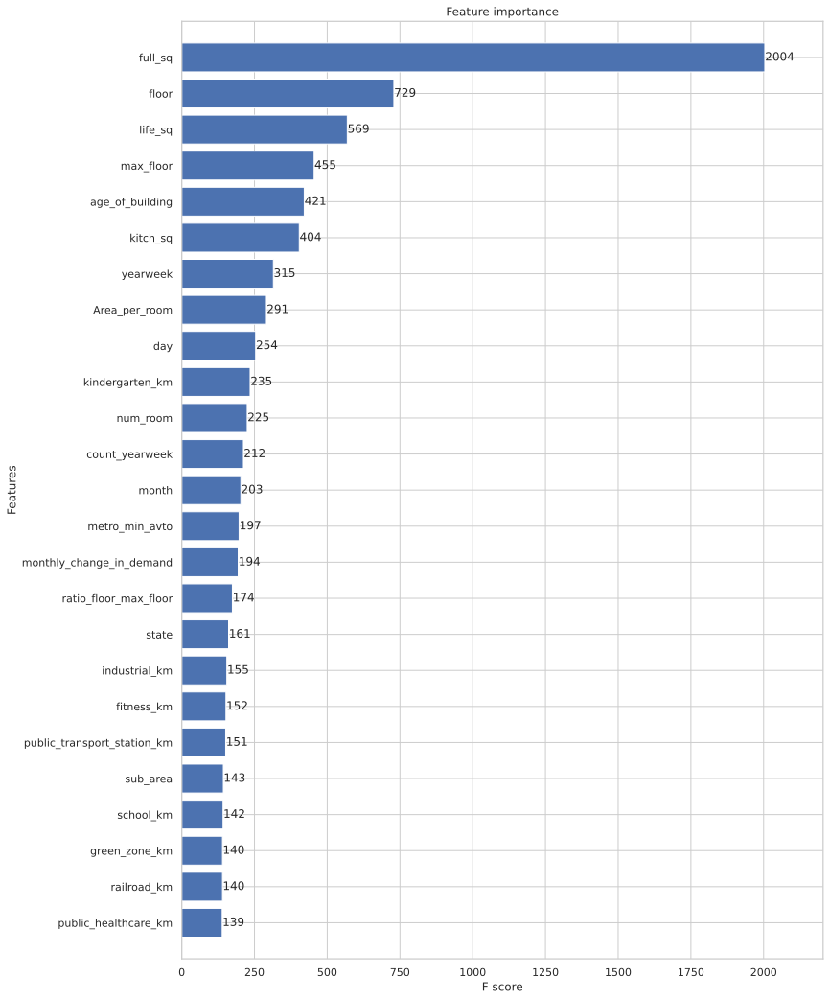

In [53]:
pred_xg,weights = ImprovedXgb(train,test)

In [54]:
df_sub = pd.DataFrame({'id': id_test, 'price_doc': pred_xg})
df_sub.to_csv('submition.csv',index=False)
df_sub

,id,price_doc
0,30474,5683416.0
1,30475,8452710.0
2,30476,5551532.0
3,30477,5924082.0
4,30478,5694579.0
...,...,...
7657,38131,9457578.0
7658,38132,6487550.5
7659,38133,5558769.0
7660,38134,5631539.0


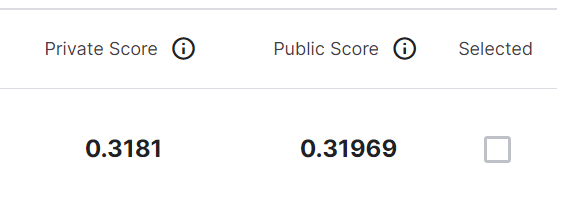

Our kaggle score 0.318 we hope to improve that score by hypertuning our model and keep creating new features that will be able to reflect the properties of the house better, we can even make an ensemble of models to see if that gives better results.

#Final Task

##Task 1 - cross validation and time splitting

In [55]:
#@title random forest 80%/20% split by time
def RF_time_split(train):
  for f in train.columns:
      if train[f].dtype=='object':
          lbl = preprocessing.LabelEncoder()
          lbl.fit(list(train[f].values)) 
          train[f] = lbl.transform(list(train[f].values))
  rf =  RandomForestRegressor(max_depth=8, random_state=0)
  sorted_train = train.sort_values(['timestamp'],ascending=True)


  train_X, test_X, train_y, test_y = train_test_split(sorted_train.iloc[:, :-1], sorted_train.iloc[:, -1], test_size=0.2, shuffle=False)

  train_X = train_X.drop(["id", "timestamp"], axis=1)
  test_X = test_X.drop(["id", "timestamp"], axis=1)

  model=rf.fit(train_X, train_y)

  pred = rf.predict(test_X)

  rmslePred = RMSLE(test_y.to_numpy(),pred)
  return rmslePred

In [56]:
#@title improved Random Forest 
def RF_random_split(train):
  for f in train.columns:
      if train[f].dtype=='object':
          lbl = preprocessing.LabelEncoder()
          lbl.fit(list(train[f].values)) 
          train[f] = lbl.transform(list(train[f].values))
          
  rf =  RandomForestRegressor(max_depth=8, random_state=0)
  train = train.drop(["id", "timestamp"], axis=1)

  X = train.iloc[:,:train.shape[1]-1]
  y = train.iloc[:,-1]

  df = pd.DataFrame(cross_validate(estimator = rf,
                                 X = X,
                                 y = y,
                                 scoring = 'neg_mean_squared_log_error',
                                 return_estimator = True,
                                 cv = KFold(n_splits = 3, 
                                           shuffle = True,
                                           random_state = 1)))
  df = df.assign(rmsle_score = (df['test_score']*-1)**0.5)

  return df['rmsle_score'].mean()

In [57]:
train_for_rf = train.dropna()
print(f'''
      by time split: {RF_time_split(train_for_rf)}
      by  random split: {RF_random_split(train_for_rf)}
      ''')

**split by time score :**

*   split by time score - **0.5475**
*   split by random split and cv score - **0.5756**


We can see that the time split has better results for our dataset, but we understand that there isnt a one answer that is true all the time, for example the housing market was very stable then the random split in combination with the cross validation probablity would have gotten a better results.

when we split the data by time, the model is able to pick up on trends that arent represented by features, for example if every year the house prices increases by 10% then the model will know to predict the the price of a similar house he saw in the train with a 10% increase just by the factor of constant rise of prices

There are several factors that may contribute to differences in the predictions of a model on housing prices when the data is split by time.

One factor is changing market conditions. Housing markets can change over time due to a variety of factors such as changes in the economy, changes in interest rates, and changes in demand for housing ( as we can see very clearly at this time). As a result, the characteristics of houses that are sold at different times may be different, which could affect the accuracy of the model's predictions.

Another factor is the availability of data. When you split the data by time, the model is trained on a limited set of data, which may not be representative of the entire housing market. This could lead to a model that is less accurate when making predictions on houses that were sold at different times.

Finally, the model itself may be sensitive to the time at which the data was collected. For example, if the model is using features such as the age of the house or the number of years since the last renovation, these features may be more relevant for houses sold at different times. As a result, the model's predictions may be more accurate when the data is split by time.








##Task 2 - Classification task


In [58]:
def label_transform(df):
  for c in df.columns:
    if df[c].dtype == 'object':
        lbl = preprocessing.LabelEncoder()
        lbl.fit(list(df[c].values))
        df[c] = lbl.transform(list(df[c].values))
  return df
  
sub_area_to_look_at='Poselenie Sosenskoe'

OnlyOne=(df_train
        .query('sub_area == @sub_area_to_look_at')
        .fillna(0)
        .assign(price_full_sq=df_train['price_doc'] / df_train['full_sq'],
                labels=lambda d:pd.qcut(d['price_full_sq'],4,labels=['Q1','Q2','Q3','Q4']))
        .pipe(lambda d:label_transform(d))
        )

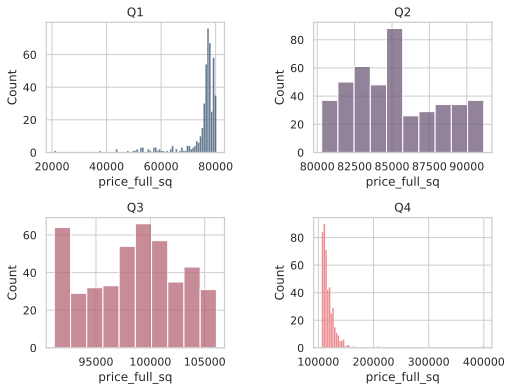

In [59]:
fig, ax = plt.subplots(2, 2, figsize = (8, 6))
fig.subplots_adjust(wspace=0.5, hspace=0.5)


Pallete = ['#355070','#6d597a','#b56576','#e56b6f']
for i, ax in enumerate(fig.axes):
        Q='Q'+str(i+1)
        sns.histplot(x = 'price_full_sq',
                     data = OnlyOne.query('labels == @Q'),
                     color = [Pallete[i]],
                     ax = ax)
        ax.set(title=Q)

plt.show()

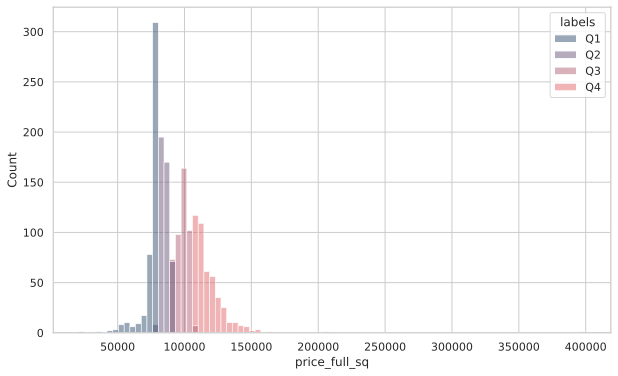

In [60]:
sns.histplot(x = 'price_full_sq', data = OnlyOne, hue = 'labels',palette = Pallete)

In [61]:


X =  OnlyOne.drop('labels',axis=1)
y =  OnlyOne['labels']

train_X, test_X, train_y, test_y = train_test_split(X, y,
                      test_size = 0.3, random_state = 123)

clf = RandomForestClassifier(max_depth=7, random_state=0)

clf.fit(train_X.drop(['timestamp','price_doc','price_full_sq'],axis=1), train_y)

pred=clf.predict(test_X.drop(['timestamp','price_doc','price_full_sq'],axis=1))

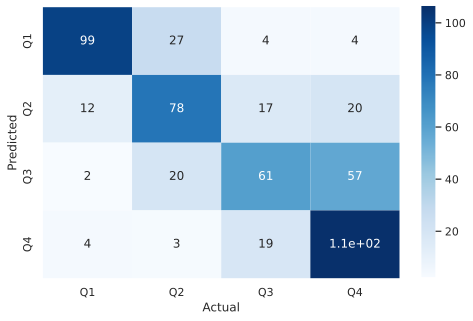

              precision    recall  f1-score   support

          Q1       0.85      0.74      0.79       134
          Q2       0.61      0.61      0.61       127
          Q3       0.60      0.44      0.51       140
          Q4       0.57      0.80      0.66       132

    accuracy                           0.65       533
   macro avg       0.66      0.65      0.64       533
weighted avg       0.66      0.65      0.64       533



In [62]:

report = classification_report(test_y, pred)

cm = confusion_matrix(test_y,pred)  
index = ['Q1','Q2','Q3','Q4']  
columns = ['Q1','Q2','Q3','Q4']  
cm_df = pd.DataFrame(cm,columns,index)

fig = plt.figure(figsize=(8,5))  
sns.heatmap(cm_df, annot=True,cmap='Blues')

plt.xlabel('Actual')
plt.ylabel('Predicted')

plt.show()
print(report)

##Task 3

final prediction has ran in the predicting section above

this task is mainly showed in the presention, we will show some of the code we used to answer it

*   List item
*   Errors exploration



##Kaggle and kfold results

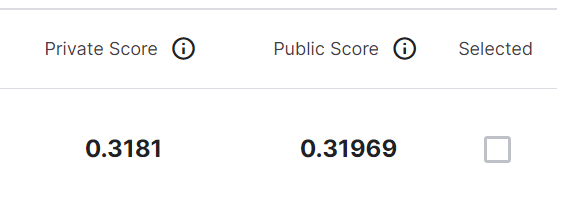

In [63]:
cv_results = XGB_with_cv(train)

In [64]:
print(f'CV results : {cv_results} \
        Kaggle results : 0.3181')

IndentationError: ignored

##Checking Errors final project

In [65]:
df_errors, Importance,pred,price_doc,train_x=Xgb_split(train)

In [66]:
items = sorted(list(Importance.items()),key=lambda x: x[1],reverse=True)
ImportantFeatures = [tup[0] for tup in items][:8]
Obs = (
      df_errors
      .assign(Over_under_est = np.where(df_errors['errors']<0, 'Over', 'Under'),
              errors = df_errors['errors'].abs(),
              prediction = pred,
              price_doc = price_doc,
              product_type = df_train['product_type'])
      [ImportantFeatures+['product_type','errors','Over_under_est','price_doc','prediction']]
      .pipe(lambda d:d.sort_values(by='errors',ascending=False))
      )

In [73]:
def make_pretty(styler):
    styler.format({'prediction':'₽{:,.0f}','price_doc':'₽{:,}','errors':'{:.0f}',
                  **{col:'{:.0f}' for col in ImportantFeatures if  'km' not in col}},
                  na_rep = 'Missing')
    styler.applymap(lambda x: 'background-color: #d62828' if pd.isna(x) else '')
    styler.applymap(lambda x: f'background-color: {"lightblue" if x == "Investment" else "lightyellow"}', subset = ['product_type'])
    styler.applymap(lambda x: f'background-color: {"lightpink" if x == "Over" else "darkviolet"}', subset = ['Over_under_est'])
    styler.highlight_max(axis = 0,color = 'b')
    styler.highlight_quantile(subset = ImportantFeatures,axis = 0, q_left = 0.9, color = "#f77f00")
    styler.background_gradient(cmap = 'Blues', subset = 'price_doc', axis = None,vmin = train.price_doc.min(),vmax = train.price_doc.max())
    styler.background_gradient(cmap = 'Greens', subset = 'errors', axis = None,vmin = Obs.errors.min(),vmax = Obs.errors.max())
    return styler

Worst = (
        Obs
        .head(10)
        .style
        .set_caption('Worst Predictions')
        .pipe(make_pretty)
         )
Best = (
         Obs
        .tail(10)
        .style
        .set_caption('Best Predictions')
        .pipe(make_pretty)
      )

display(Worst)
display(Best)

,full_sq,floor,life_sq,max_floor,kitch_sq,age_of_building,yearweek,Area_per_room,product_type,errors,Over_under_est,price_doc,prediction
7457,66,33,66,Missing,Missing,Missing,201316,Missing,Investment,73625528,Under,"₽91,066,096","₽17,440,568"
19095,85,10,85,47,54,14,201422,85,Investment,44617648,Under,"₽80,777,440","₽36,159,792"
11085,76,16,76,28,12,12,201341,19,Investment,39948090,Under,"₽71,200,000","₽31,251,910"
27460,151,15,Missing,Missing,1,3,201504,Missing,OwnerOccupier,36388708,Under,"₽71,249,624","₽34,860,916"
18337,168,5,Missing,5,Missing,Missing,201420,Missing,OwnerOccupier,34229780,Under,"₽69,818,672","₽35,588,892"
20219,97,6,97,7,23,106,201426,24,Investment,30673728,Over,"₽10,000,000","₽40,673,728"
18777,30,18,30,22,8,35,201421,15,Investment,30581092,Over,"₽10,700,000","₽41,281,092"
16743,303,32,Missing,32,Missing,Missing,201414,Missing,OwnerOccupier,27398238,Under,"₽54,212,936","₽26,814,698"
19513,134,6,134,25,57,18,201424,27,Investment,24839938,Under,"₽55,000,000","₽30,160,062"
18525,232,11,232,37,26,9,201420,46,Investment,23010978,Over,"₽15,919,294","₽38,930,272"


,full_sq,floor,life_sq,max_floor,kitch_sq,age_of_building,yearweek,Area_per_room,product_type,errors,Over_under_est,price_doc,prediction
23812,38,5,Missing,17,1,Missing,201443,Missing,OwnerOccupier,1052,Over,"₽4,850,149","₽4,851,200"
16164,44,2,44,12,12,13,201412,15,Investment,972,Over,"₽10,000,000","₽10,000,972"
24298,38,9,Missing,17,Missing,Missing,201445,Missing,OwnerOccupier,934,Over,"₽4,915,086","₽4,916,020"
5739,38,11,Missing,Missing,Missing,Missing,201304,Missing,OwnerOccupier,796,Over,"₽4,160,000","₽4,160,796"
27475,53,1,53,5,9,84,201504,18,Investment,688,Under,"₽10,600,000","₽10,599,312"
2385,23,1,23,Missing,Missing,Missing,201223,Missing,Investment,552,Over,"₽5,177,000","₽5,177,552"
24884,19,12,19,12,9,53,201447,19,Investment,458,Over,"₽5,250,000","₽5,250,458"
22396,20,4,20,5,5,55,201437,20,Investment,279,Over,"₽5,800,000","₽5,800,279"
5948,79,5,Missing,Missing,Missing,Missing,201306,Missing,OwnerOccupier,258,Over,"₽6,376,392","₽6,376,650"
21224,76,9,Missing,17,1,Missing,201431,Missing,OwnerOccupier,34,Under,"₽6,346,740","₽6,346,706"


we are looking at the biggest error that is under perdicted  index =7457. the price value of this house is the max in the test and in the train data there are less the 1% of data points that are similar to this price range. therefore are model had a hard time predicting it because it was far off from the range it nows and that can explain the underestimation.
the training data is not representative of the true distribution of the data, therefore we think our model made a bad predictions on new, unseen data.
the full sq,life sq,extra sq is bigger then 75% of the data therefore its harder to predict unfamilier data.
life to full ratio is substantialy lower then the 25% of the data.


we are looking at the biggest over estimated prediction index = 20219	and 9852
full sq, life sq bigger
the price is round this made us suspicious.
the house is an invesment and therefore we think that is was prices at a lower price then its real value and we think that some shaddy buisness went down.

#Sources Of Information


kaggle:

https://www.kaggle.com/learn/intermediate-machine-learning

https://www.kaggle.com/learn/feature-engineering

https://www.kaggle.com/learn/data-cleaning

https://www.kaggle.com/code/jtremoureux/map-visualizations-with-external-shapefile

https://www.kaggle.com/code/keremt/very-extensive-cleaning-by-sberbank-discussions

https://www.kaggle.com/code/solegalli/feature-engineering-for-house-price-modelling

https://www.kaggle.com/code/jesucristo/1-house-prices-solution-top-1#Blending-Models

https://www.kaggle.com/code/abhinavjhanwar/house-price-prediction-r2-score-94#Handling-Categorical-Features-(Label-Encoding-&-One-Hot-Encoding)%C2%B6

https://www.kaggle.com/code/ohseokkim/linear-nonlinear-scaling

https://www.kaggle.com/code/lavanyashukla01/how-i-made-top-0-3-on-a-kaggle-competition

https://www.kaggle.com/code/alexisbcook/missing-values

https://www.kaggle.com/code/demesgal/magic-numbers

https://www.kaggle.com/code/philippsp/an-updated-collection-of-new-features

https://www.kaggle.com/code/prashant111/xgboost-k-fold-cv-feature-importance

https://www.kaggle.com/code/prashant111/a-guide-on-xgboost-hyperparameters-tuning/notebook


---


  



towards data sciene:


https://towardsdatascience.com/creating-python-functions-for-exploratory-data-analysis-and-data-cleaning-2c462961bd71

https://towardsdatascience.com/ml-algorithm-that-natively-supports-missing-values-40b42559c1ec

https://towardsdatascience.com/how-to-use-python-and-missforest-algorithm-to-impute-missing-data-ed45eb47cb9a

https://towardsdatascience.com/catboost-vs-lightgbm-vs-xgboost-c80f40662924

https://towardsdatascience.com/understanding-feature-engineering-part-2-categorical-data-f54324193e63

https://towardsdatascience.com/an-introduction-to-discretization-in-data-science-55ef8c9775a2

https://towardsdatascience.com/finding-distance-between-two-latitudes-and-longitudes-in-python-43e92d6829ff

https://towardsdatascience.com/7-ways-to-handle-missing-values-in-machine-learning-1a6326adf79e

https://towardsdatascience.com/how-to-create-new-features-using-clustering-4ae772387290

https://towardsdatascience.com/targeting-multicollinearity-with-python-3bd3b4088d0b

https://towardsdatascience.com/exploratory-data-analysis-in-python-a-step-by-step-process-d0dfa6bf94ee




---

git-hub:

---

https://github.com/ashishpatel26/Amazing-Feature-Engineering

https://github.com/aikho/awesome-feature-engineering

https://etav.github.io/python/vif_factor_python.html

https://github.com/Rushi21-kesh/Handling-Missing-Values

https://github.com/DivyaKrishnani/Data-Preprocessing-with-Python/blob/master/HandlingMissingValues.ipynb

https://github.com/Rushi21-kesh/Handling-Missing-Values/blob/main/Handling%20Categorical%20Data.ipynb


etc:

https://www.kdnuggets.com/2022/08/tuning-xgboost-hyperparameters.html

https://www.globalpropertyguide.com/home-price-trends/Russia

https://machinelearningmastery.com/discretization-transforms-for-machine-learning/

https://nycdatascience.com/blog/student-works/house-price-prediction-with-creative-feature-engineering-and-advanced-regression-techniques/

https://medium.com/swlh/explained-kaggle-housing-prices-feature-engineering-and-ridge-regression-88934ad37edc

https://medium.com/@petehouston/calculate-distance-of-two-locations-on-earth-using-python-1501b1944d97

https://stats.stackexchange.com/questions/410939/label-encoding-vs-dummy-variable-one-hot-encoding-correctness

https://www.kdnuggets.com/2015/12/beyond-one-hot-exploration-categorical-variables.html



https://www.statisticshowto.com/probability-and-statistics/normal-distributions/box-cox-transformation/

https://medium.com/@24littledino/k-fold-cv-hyper-parameter-tuning-in-python-4ad95880e477



---




articles

---

Machine Learning Students Overfit to Overfitting -
https://arxiv.org/pdf/2209.03032.pdf

A study on using data clustering for feature extraction to improve the quality of classification -
https://link.springer.com/article/10.1007/s10115-021-01572-6
